# Pycaret clustering harinas

---

[Limpieza de datos](#Limpieza-de-datos)

[Clusterizado](#Clusterizado)

[Exportación del modelo](#Exportación-del-modelo)

## Limpieza de datos
---
Obtiene datos re los registros

In [1]:
import pandas as pd
pd.set_option('display.max_columns', None)

In [2]:
df = pd.read_csv('./data/base.csv')

C:\Users\lacia\AppData\Local\Temp\ipykernel_6076\1628910066.py:1: DtypeWarning: Columns (5,7,8,9,12,14,15,16,17,18) have mixed types. Specify dtype option on import or set low_memory=False.
  df = pd.read_csv('./data/base.csv')


In [3]:
df.head()

,Unnamed: 0,key,bandera_id,lat,lng,sucursalnombre,id_,sucursaltipo,provincia,promo1_descripcion,promo1_precio,preciolista,promo2_descripcion,promo2_precio,actualizadohoy,direccion,banderadescripcion,localidad,comerciorazonsocial,comercioid,marca,nombre,presentacion,fecha
0,0,sucursales,1,-34.603651,-58.405234,384 - BALVANERA,7790070012050,Autoservicio,AR-C,0% de descuento. Precio Promocional Exclusivo ...,186.37,186.37,NaN,NaN,True,Av Pueyrredon 576 (Balvanera),Supermercados DIA,CAPITAL FEDERAL,DIA Argentina S.A,15,COCINERO,Aceite de Girasol Cocinero 900 Ml,900.0 ml,2022-08-24
1,1,sucursales,1,-34.676463,-58.493397,386 - VILLA LUGANO,7790070012050,Autoservicio,AR-C,0% de descuento. Precio Promocional Exclusivo ...,186.37,186.37,NaN,NaN,True,Montiel 3829 (Villa Lugano),Supermercados DIA,CAPITAL FEDERAL,DIA Argentina S.A,15,COCINERO,Aceite de Girasol Cocinero 900 Ml,900.0 ml,2022-08-24
2,2,sucursales,1,-34.653074,-58.481413,387 - PARQUE AVELLANEDA,7790070012050,Autoservicio,AR-C,0% de descuento. Precio Promocional Exclusivo ...,186.37,186.37,NaN,NaN,True,Av Olivera 1268 (Villa Lugano),Supermercados DIA,CAPITAL FEDERAL,DIA Argentina S.A,15,COCINERO,Aceite de Girasol Cocinero 900 Ml,900.0 ml,2022-08-24
3,3,sucursales,1,-34.626284,-58.456988,389 - FLORES,7790070012050,Autoservicio,AR-C,0% de descuento. Precio Promocional Exclusivo ...,186.37,186.37,NaN,NaN,True,Av Boyaca 37 (Flores),Supermercados DIA,CAPITAL FEDERAL,DIA Argentina S.A,15,COCINERO,Aceite de Girasol Cocinero 900 Ml,900.0 ml,2022-08-24
4,4,sucursales,1,-35.053089,-58.760641,39 - CAÑUELAS,7790070012050,Autoservicio,AR-B,0% de descuento. Precio Promocional Exclusivo ...,186.37,186.37,NaN,NaN,True,Cl Rivadavia 800,Supermercados DIA,BUENOS AIRES,DIA Argentina S.A,15,COCINERO,Aceite de Girasol Cocinero 900 Ml,900.0 ml,2022-08-24


In [4]:
df.shape

(1153800, 24)

In [5]:
print(df.fecha.max())
print(df.fecha.min())

2022-08-25
2022-06-11


In [6]:
df.dtypes

Unnamed: 0               int64
key                     object
bandera_id               int64
lat                    float64
lng                    float64
sucursalnombre          object
id_                      int64
sucursaltipo            object
provincia               object
promo1_descripcion      object
promo1_precio          float64
preciolista            float64
promo2_descripcion      object
promo2_precio          float64
actualizadohoy          object
direccion               object
banderadescripcion      object
localidad               object
comerciorazonsocial     object
comercioid               int64
marca                   object
nombre                  object
presentacion            object
fecha                   object
dtype: object

In [7]:
df['fecha'] = pd.to_datetime(df['fecha'], format='%Y-%m-%d')

In [8]:
#Filtro universo harinas
marcas_harina = ['CASERITA','MORIXE','FAVORITA']
df_harina = df.loc[df['marca'].isin(marcas_harina)]
df_harina.head()

,Unnamed: 0,key,bandera_id,lat,lng,sucursalnombre,id_,sucursaltipo,provincia,promo1_descripcion,promo1_precio,preciolista,promo2_descripcion,promo2_precio,actualizadohoy,direccion,banderadescripcion,localidad,comerciorazonsocial,comercioid,marca,nombre,presentacion,fecha
79,79,sucursales,1,NaN,NaN,NaN,7790070507242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-22
80,80,sucursales,1,NaN,NaN,NaN,7790070507242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-22
81,81,sucursales,1,NaN,NaN,NaN,7790070507242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-22
82,82,sucursales,2,NaN,NaN,NaN,7790070507242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,10,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-22
83,83,sucursales,1,NaN,NaN,NaN,7790070507242,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-22


In [9]:
#Filtro registros con datos
df_harina = df_harina[df_harina['preciolista']> 0]
df_harina.head()

,Unnamed: 0,key,bandera_id,lat,lng,sucursalnombre,id_,sucursaltipo,provincia,promo1_descripcion,promo1_precio,preciolista,promo2_descripcion,promo2_precio,actualizadohoy,direccion,banderadescripcion,localidad,comerciorazonsocial,comercioid,marca,nombre,presentacion,fecha
298,298,sucursales,5,-34.484169,-58.595829,San Fernando,7790070507242,Hipermercado,AR-B,"Llevando este producto, pagás $135.99 hasta e...",135.99,160.00,NaN,NaN,True,Cno Bancalari E/202 Y Uruguay,Walmart SuperCenter,SAN FERNANDO,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24
299,299,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790070507242,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",135.99,166.00,NaN,NaN,True,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24
300,300,sucursales,5,-32.850687,-68.858646,Las Heras,7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $145.00 hasta e...",144.99,145.06,NaN,NaN,True,Boulogne Sur Mer Y Regalado Olguin,Walmart SuperCenter,MENDOZA CIUDAD,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24
301,301,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",135.99,145.06,NaN,NaN,True,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24
599,599,sucursales,2,-34.913497,-57.951821,La Plata I,7792590000227,Supermercado,AR-B,NaN,NaN,163.50,NaN,NaN,True,Calle 7 767,Market,La Plata,INC S.A.,10,CASERITA,Harina de Trigo 0000 Caserita 1 Kg,1.0 kg,2022-08-17


In [10]:
df_harina.shape

(213228, 24)

In [11]:
#Filtro registros con datos
df_harina_d = df_harina.loc[df_harina['fecha'] >= '2022-8-24']
df_harina_d.head()

,Unnamed: 0,key,bandera_id,lat,lng,sucursalnombre,id_,sucursaltipo,provincia,promo1_descripcion,promo1_precio,preciolista,promo2_descripcion,promo2_precio,actualizadohoy,direccion,banderadescripcion,localidad,comerciorazonsocial,comercioid,marca,nombre,presentacion,fecha
298,298,sucursales,5,-34.484169,-58.595829,San Fernando,7790070507242,Hipermercado,AR-B,"Llevando este producto, pagás $135.99 hasta e...",135.99,160.00,NaN,NaN,True,Cno Bancalari E/202 Y Uruguay,Walmart SuperCenter,SAN FERNANDO,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24
299,299,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790070507242,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",135.99,166.00,NaN,NaN,True,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24
300,300,sucursales,5,-32.850687,-68.858646,Las Heras,7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $145.00 hasta e...",144.99,145.06,NaN,NaN,True,Boulogne Sur Mer Y Regalado Olguin,Walmart SuperCenter,MENDOZA CIUDAD,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24
301,301,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",135.99,145.06,NaN,NaN,True,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24
1061443,1061443,sucursales,1,-32.426197,-63.738309,1513 - HERNANDO,7792590000227,Autoservicio,AR-X,NaN,NaN,161.13,NaN,NaN,True,Bv Rivadavia 300,Supermercados DIA,CORDOBA,DIA Argentina S.A,15,CASERITA,Harina de Trigo 0000 Caserita 1 Kg,1.0 kg,2022-08-25


In [12]:
df_harina_d.shape

(7475, 24)

# Kmeans

---
Se utilizarán las variables lat, lng, sucursaltipo, promo1_precio, preciolista, promo2_precio, marca

In [13]:
import pycaret.clustering as pc

In [14]:
from pycaret.clustering import *

In [15]:
df_harina_d.keys()

Index(['Unnamed: 0', 'key', 'bandera_id', 'lat', 'lng', 'sucursalnombre',
       'id_', 'sucursaltipo', 'provincia', 'promo1_descripcion',
       'promo1_precio', 'preciolista', 'promo2_descripcion', 'promo2_precio',
       'actualizadohoy', 'direccion', 'banderadescripcion', 'localidad',
       'comerciorazonsocial', 'comercioid', 'marca', 'nombre', 'presentacion',
       'fecha'],
      dtype='object')

In [30]:
features_i = []
features_i = ['Unnamed: 0', 'key', 'bandera_id', 'sucursalnombre',
       'id_', 'sucursaltipo', 'provincia', 'promo1_descripcion',
       'promo2_descripcion',
       'actualizadohoy', 'direccion', 'banderadescripcion', 'localidad',
       'comerciorazonsocial', 'comercioid', 'nombre', 'presentacion',
       'fecha']

In [32]:
clf1 = pc.setup(data = df_harina_d, use_gpu=True, ignore_features = features_i) #ver si mejor o no normalize , normalize = True 

,Description,Value
0,session_id,8078
1,Original Data,"(7475, 24)"
2,Missing Values,True
3,Numeric Features,5
4,Categorical Features,1
5,Ordinal Features,False
6,High Cardinality Features,False
7,High Cardinality Method,None
8,Transformed Data,"(7475, 8)"
9,CPU Jobs,-1


In [18]:
pc.models()

,Name,Reference
ID,,
kmeans,K-Means Clustering,sklearn.cluster._kmeans.KMeans
ap,Affinity Propagation,sklearn.cluster._affinity_propagation.Affinity...
meanshift,Mean Shift Clustering,sklearn.cluster._mean_shift.MeanShift
sc,Spectral Clustering,sklearn.cluster._spectral.SpectralClustering
hclust,Agglomerative Clustering,sklearn.cluster._agglomerative.AgglomerativeCl...
dbscan,Density-Based Spatial Clustering,sklearn.cluster._dbscan.DBSCAN
optics,OPTICS Clustering,sklearn.cluster._optics.OPTICS
birch,Birch Clustering,sklearn.cluster._birch.Birch
kmodes,K-Modes Clustering,kmodes.kmodes.KModes


In [33]:
kmeans = pc.create_model('kmeans', num_clusters = 5)

,Silhouette,Calinski-Harabasz,Davies-Bouldin,Homogeneity,Rand Index,Completeness
0,0.559,7662.43,0.7448,0,0,0


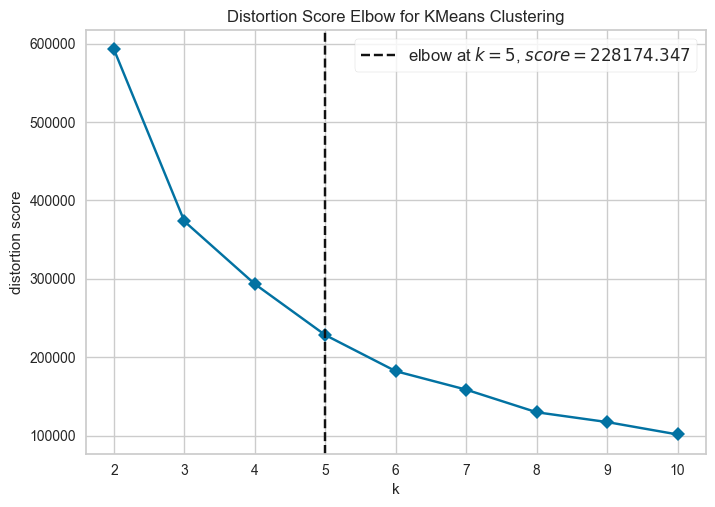

In [34]:
plot_model(kmeans, 'elbow')

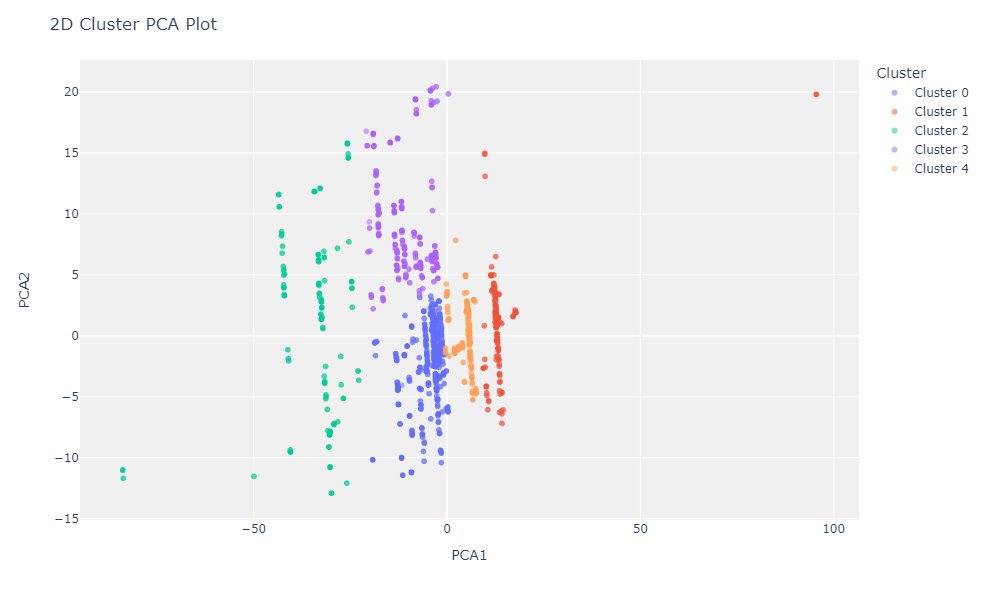

In [35]:
plot_model(kmeans, 'cluster')

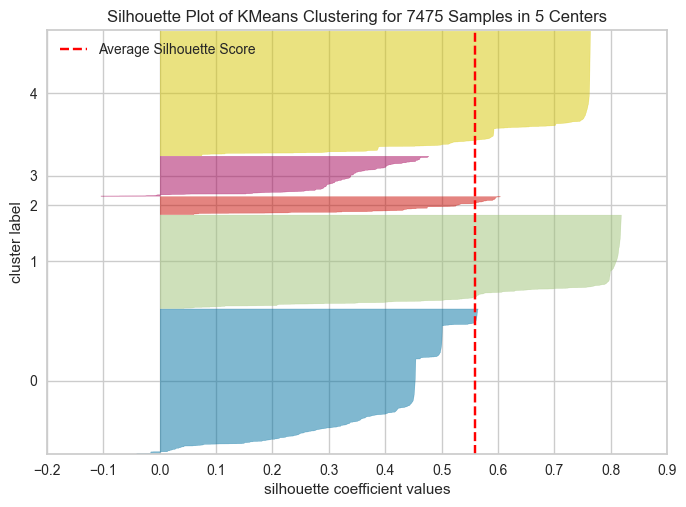

In [36]:
plot_model(kmeans, plot = 'silhouette')

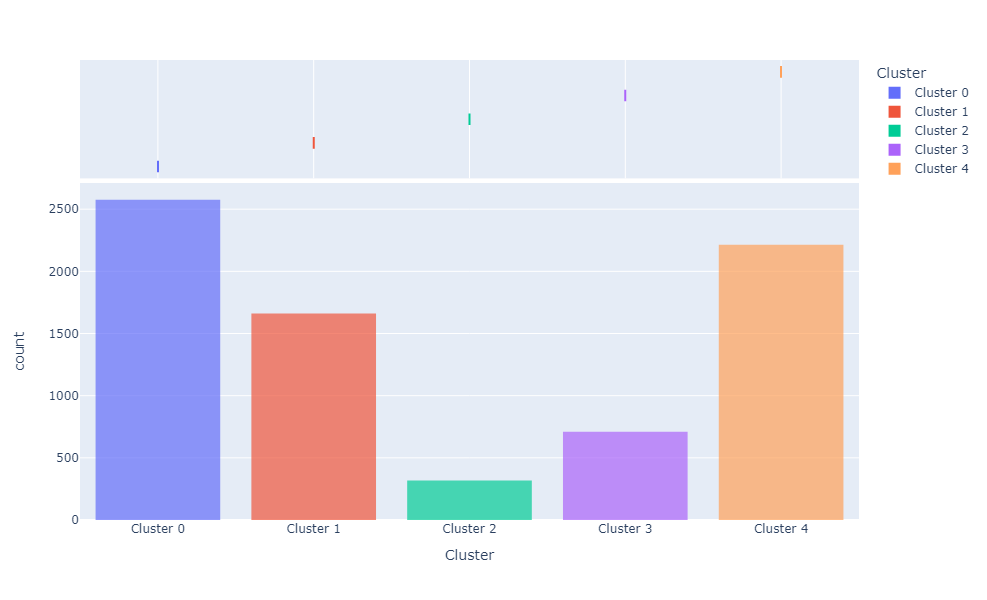

In [37]:
plot_model(kmeans, plot = 'distribution')

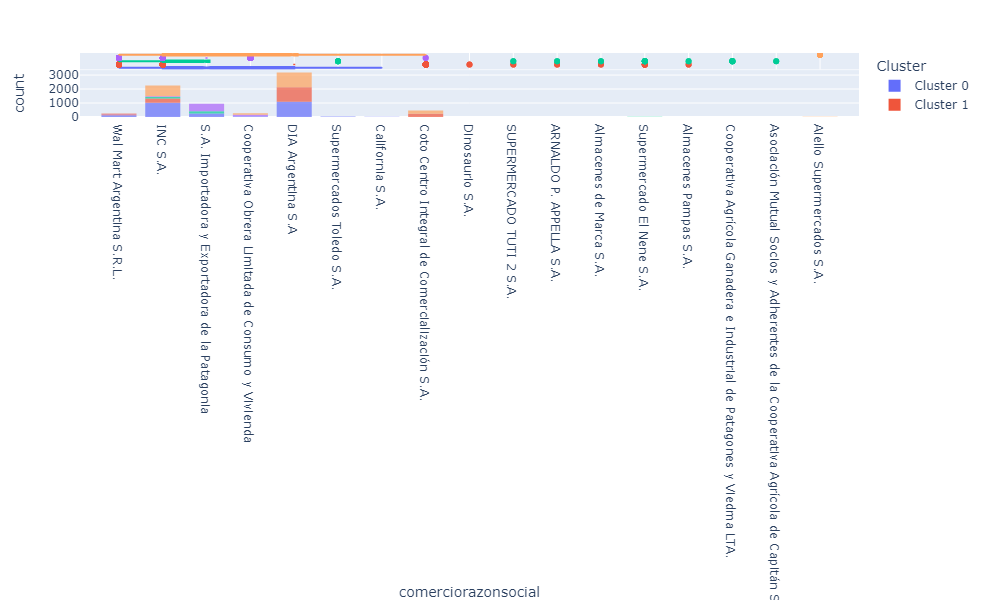

In [38]:
plot_model(kmeans, plot = 'distribution', feature = 'comerciorazonsocial')

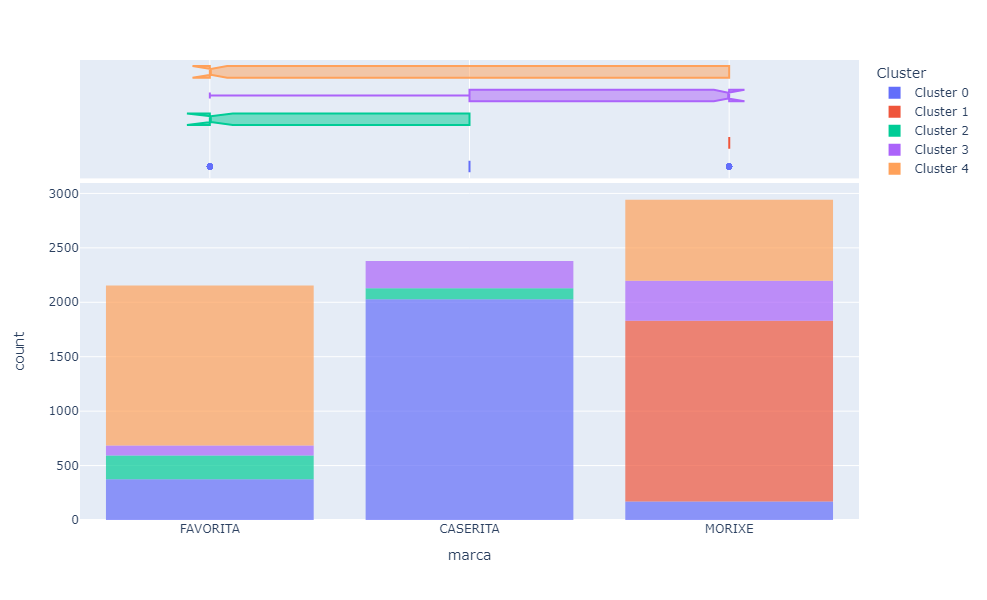

In [39]:
plot_model(kmeans, plot = 'distribution', feature = 'marca')

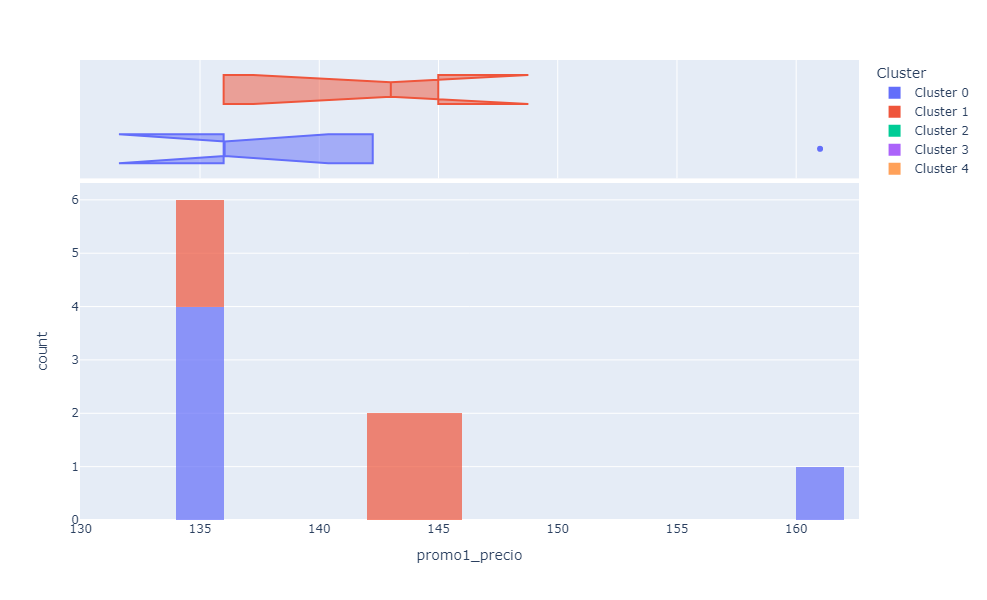

In [40]:
plot_model(kmeans, plot = 'distribution', feature = 'promo1_precio')

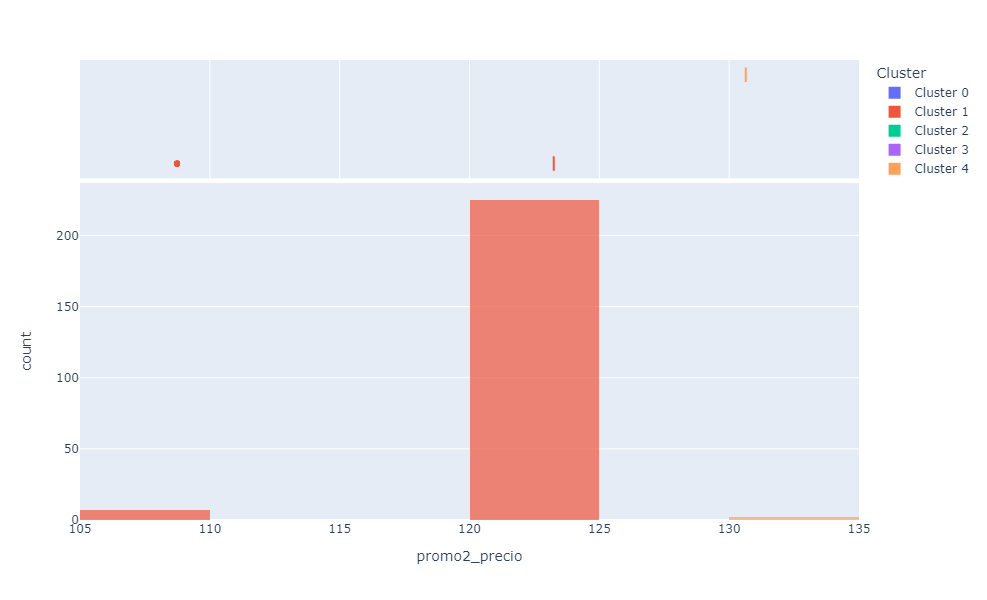

In [41]:
plot_model(kmeans, plot = 'distribution', feature = 'promo2_precio')

In [42]:
save_model(kmeans, 'clustering_model')
results = assign_model(kmeans)
results.head(10)

Transformation Pipeline and Model Successfully Saved


,Unnamed: 0,key,bandera_id,lat,lng,sucursalnombre,id_,sucursaltipo,provincia,promo1_descripcion,...,direccion,banderadescripcion,localidad,comerciorazonsocial,comercioid,marca,nombre,presentacion,fecha,Cluster
298,298,sucursales,5,-34.484169,-58.595829,San Fernando,7790070507242,Hipermercado,AR-B,"Llevando este producto, pagás $135.99 hasta e...",...,Cno Bancalari E/202 Y Uruguay,Walmart SuperCenter,SAN FERNANDO,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24,Cluster 0
299,299,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790070507242,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",...,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-24,Cluster 0
300,300,sucursales,5,-32.850687,-68.858646,Las Heras,7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $145.00 hasta e...",...,Boulogne Sur Mer Y Regalado Olguin,Walmart SuperCenter,MENDOZA CIUDAD,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24,Cluster 1
301,301,sucursales,5,-32.914510,-68.825287,Mendoza (24hs),7790199000020,Hipermercado,AR-M,"Llevando este producto, pagás $136.00 hasta e...",...,Moldes 1023,Walmart SuperCenter,VILLANUEVA,Wal Mart Argentina S.R.L.,11,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-24,Cluster 1
1061443,1061443,sucursales,1,-32.426197,-63.738309,1513 - HERNANDO,7792590000227,Autoservicio,AR-X,NaN,...,Bv Rivadavia 300,Supermercados DIA,CORDOBA,DIA Argentina S.A,15,CASERITA,Harina de Trigo 0000 Caserita 1 Kg,1.0 kg,2022-08-25,Cluster 0
1061959,1061959,sucursales,1,-35.053089,-58.760641,39 - CAÑUELAS,7790070507242,Autoservicio,AR-B,NaN,...,Cl Rivadavia 800,Supermercados DIA,BUENOS AIRES,DIA Argentina S.A,15,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-25,Cluster 4
1061965,1061965,sucursales,2,-32.868658,-68.852646,Mendoza Sexta,7790070507242,Supermercado,AR-M,NaN,...,Jorge A. Calle 631,Market,Mendoza,INC S.A.,10,FAVORITA,Harina 0000 Vitazink Favorita 1 Kg,1.0 kg,2022-08-25,Cluster 0
1061970,1061970,sucursales,3,-34.851160,-58.077030,Av. Arana 231,7790199000020,Supermercado,AR-B,NaN,...,Av. Arana 231,Express,La Plata,INC S.A.,10,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-25,Cluster 4
1061973,1061973,sucursales,1,-34.665007,-58.362318,AVELLANEDA,7790199000020,Supermercado,AR-B,NaN,...,Italia 62,COTO CICSA,Avellaneda,Coto Centro Integral de Comercialización S.A.,12,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-25,Cluster 1
1061974,1061974,sucursales,1,-34.743716,-58.289187,QUILMES,7790199000020,Supermercado,AR-B,NaN,...,12 De Octubre 3054,COTO CICSA,Quilmes,Coto Centro Integral de Comercialización S.A.,12,MORIXE,Harina de Trigo 0000 Morixe 1 Kg,1.0 kg,2022-08-25,Cluster 1


In [43]:
#Exportación modelo
results.to_csv('./data/Kmeans_Harina_25-8.csv')

# Kmeans sin lat y long

---

In [ ]:
import pycaret.clustering as pc

In [ ]:
from pycaret.clustering import *

In [ ]:
df_harina_d.keys()

In [ ]:
features_i = []
features_i = ['Unnamed: 0', 'key', 'bandera_id', 'lat', 'lng','sucursalnombre',
       'id_', 'provincia', 'promo1_descripcion',
       'promo2_descripcion',
       'actualizadohoy', 'direccion', 'banderadescripcion', 'localidad',
       'comerciorazonsocial', 'comercioid', 'nombre', 'presentacion',
       'fecha']

In [ ]:
clf1 = pc.setup(data = df_harina_d, use_gpu=True, ignore_features = features_i)

In [ ]:
pc.models()

In [ ]:
kmeans = pc.create_model('kmeans', num_clusters = 5)

In [ ]:
plot_model(kmeans, 'elbow')

In [ ]:
plot_model(kmeans, 'cluster')

In [ ]:
plot_model(kmeans, plot = 'silhouette')

In [ ]:
plot_model(kmeans, plot = 'distribution')

In [ ]:
plot_model(kmeans, plot = 'distribution', feature = 'comerciorazonsocial')

In [ ]:
plot_model(kmeans, plot = 'distribution', feature = 'marca')

In [ ]:
save_model(kmeans, 'clustering_model')
results = assign_model(kmeans)
results.head(10)

In [ ]:
#Exportación modelo
results.to_csv('./data/Kmeans_Harina_25-8_sin_lat.csv')

# Kmeans precio y marca

---

In [ ]:
import pycaret.clustering as pc

In [ ]:
from pycaret.clustering import *

In [ ]:
df_harina_d.keys()

In [ ]:
features_i = []
features_i = ['Unnamed: 0', 'key', 'bandera_id', 'lat', 'lng', 'sucursalnombre',
       'id_', 'sucursaltipo', 'provincia', 'promo1_descripcion',
       'promo1_precio', 'promo2_descripcion', 'promo2_precio',
       'actualizadohoy', 'direccion', 'banderadescripcion', 'localidad',
       'comerciorazonsocial', 'comercioid', 'nombre', 'presentacion',
       'fecha']

In [ ]:
clf1 = pc.setup(data = df_harina_d, use_gpu=True, ignore_features = features_i)

In [ ]:
pc.models()

In [ ]:
kmeans = pc.create_model('kmeans', num_clusters = 5)

In [ ]:
plot_model(kmeans, 'elbow')

In [ ]:
plot_model(kmeans, 'cluster')

In [ ]:
plot_model(kmeans, plot = 'silhouette')

In [ ]:
plot_model(kmeans, plot = 'distribution')

In [ ]:
plot_model(kmeans, plot = 'distribution', feature = 'comerciorazonsocial')

In [ ]:
plot_model(kmeans, plot = 'distribution', feature = 'marca')

In [ ]:
save_model(kmeans, 'clustering_model')
results = assign_model(kmeans)
results.head(10)

In [ ]:
#Exportación modelo
results.to_csv('./data/Kmeans_Harina_25-8_precio_marca.csv')

# Affinity propagation

---

In [ ]:
import pycaret.clustering as pc

In [ ]:
from pycaret.clustering import *

In [ ]:
df_harina_d.keys()

In [ ]:
features_i = []
features_i = ['Unnamed: 0', 'key', 'bandera_id', 'sucursalnombre',
       'id_', 'provincia', 'promo1_descripcion',
       'promo2_descripcion',
       'actualizadohoy', 'direccion', 'banderadescripcion', 'localidad',
       'comerciorazonsocial', 'comercioid', 'nombre', 'presentacion',
       'fecha']

In [ ]:
clf1 = pc.setup(data = df_harina_d, use_gpu=True, ignore_features = features_i)

In [ ]:
pc.models()

In [ ]:
ap = pc.create_model('ap', num_clusters = 5)

In [ ]:
plot_model(ap, 'elbow')

In [ ]:
plot_model(ap, 'cluster')

In [ ]:
plot_model(kmeans, plot = 'silhouette')

In [ ]:
plot_model(kmeans, plot = 'distribution')

In [ ]:
plot_model(kmeans, plot = 'distribution', feature = 'comerciorazonsocial')

In [ ]:
plot_model(kmeans, plot = 'distribution', feature = 'marca')

In [ ]:
save_model(kmeans, 'clustering_model')
results = assign_model(kmeans)
results.head(10)

In [ ]:
#Exportación modelo
results.to_csv('./data/Kmeans_Harina_25-8_precio_marca.csv')